# **The Green Divide:** Examining the Relationship Between Park Access and Income in Toronto

**Patrick A. Mikkelsen**  //  1010572514 // University of Toronto  //  21 October 2025

---

## Abstract

This study investigates the spatial relationship between median household income and access to green space across census tracts in the City of Toronto using 2021 Census data. Previous research has established links between limited access to natural environments and adverse mental health outcomes, while studies in other Canadian municipalities have documented disparities in green space distribution along socioeconomic lines. This analysis employs spatial data analysis techniques to quantify green space per capita across 622 census tracts and examines the correlation with median household income. Through statistical analysis and spatial visualization, this study aims to determine whether income-based inequities in green space access exist in Toronto's urban landscape.

## 1. Methodology

### 1.1 Required Libraries

This analysis utilizes Python libraries for geospatial analysis ([GeoPandas](https://geopandas.org/en/stable/)), statistical computing ([SciPy](https://docs.scipy.org/doc/scipy/), [NumPy](https://numpy.org/doc/stable/)), data manipulation ([Pandas](https://pandas.pydata.org/docs/)), and visualization ([Matplotlib](https://matplotlib.org/), [Seaborn](https://seaborn.pydata.org/), [Folium](https://python-visualization.github.io/folium/latest/)).

In [2]:
import geopandas as gpd
import pandas as pd
import folium
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns

# Set visualization style
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (12, 6)
plt.rcParams['font.size'] = 10

### 1.2 Data Sources and Preparation

#### Census Tract Boundaries

[Census tract boundaries from Statistics Canada's 2021 Census](https://www12.statcan.gc.ca/census-recensement/2021/geo/sip-pis/boundary-limites/index2021-eng.cfm?Year=21) are loaded and transformed to the WGS84 coordinate reference system (EPSG:4326). Census tracts represent small, relatively stable geographic units designed to be homogeneous with respect to population characteristics, economic status, and living conditions.

In [3]:
census_boundaries = gpd.read_file("lct_000b21a_e/lct_000b21a_e.shp")
census_boundaries = census_boundaries.to_crs(epsg=4326)

#### Census Demographic and Economic Data

The 2021 Census Profile dataset contains demographic and socioeconomic characteristics for all census geographic areas in Canada. Census tract-level records are extracted for subsequent analysis.

In [4]:
census_data = pd.read_csv("98-401-X2021007_eng_CSV/98-401-X2021007_English_CSV_data.csv", 
                          encoding="latin1", low_memory=False)
ct_data = census_data[census_data['GEO_LEVEL'] == 'Census tract'].copy()

#### Spatial Delimitation to City of Toronto

To focus the analysis on Toronto proper (Census Subdivision Code 3520005), census tract boundaries are clipped to the municipal boundary, excluding surrounding municipalities within the Greater Toronto Area.

In [5]:
csd_boundaries = gpd.read_file("lcsd000b21a_e/lcsd000b21a_e.shp")
toronto_csd = csd_boundaries[csd_boundaries['CSDUID'] == '3520005'].copy()

if toronto_csd.crs != census_boundaries.crs:
    toronto_csd = toronto_csd.to_crs(census_boundaries.crs)

toronto_boundaries = gpd.clip(census_boundaries, toronto_csd)
toronto_boundaries = toronto_boundaries.to_crs(epsg=4326)

toronto_dguid_list = toronto_boundaries['DGUID'].tolist()
toronto_ct_data = ct_data[ct_data['DGUID'].isin(toronto_dguid_list)].copy()

#### Population and Income Variables

Population counts and median household income data are extracted from the census profile. These variables serve as the dependent and independent measures for analyzing green space equity.

In [6]:
population_data = toronto_ct_data[
    (toronto_ct_data['CHARACTERISTIC_NAME'] == 'Population, 2021')
][['DGUID', 'C1_COUNT_TOTAL']].copy()
population_data.rename(columns={'C1_COUNT_TOTAL': 'POPULATION'}, inplace=True)
population_data['POPULATION'] = pd.to_numeric(population_data['POPULATION'], errors='coerce')

income_data = toronto_ct_data[
    toronto_ct_data['CHARACTERISTIC_NAME'].str.contains('Median total income of household', case=False, na=False)
][['DGUID', 'C1_COUNT_TOTAL']].copy()
income_data.rename(columns={'C1_COUNT_TOTAL': 'MEDIAN_INCOME'}, inplace=True)
income_data['MEDIAN_INCOME'] = pd.to_numeric(income_data['MEDIAN_INCOME'], errors='coerce')

#### Green Space Data

Municipal green space data includes parks, ravines, golf courses, and other vegetated areas within Toronto's boundaries. Spatial data are standardized to the WGS84 coordinate system for compatibility with census boundaries.

In [7]:
green_spaces = gpd.read_file("Green Spaces - 4326/Green Spaces - 4326.shp")

### 1.3 Spatial Analysis: Green Space Calculation

To calculate accurate area measurements, all spatial data are projected to UTM Zone 17N (EPSG:26917), a metric coordinate system. Green space area within each census tract is computed through spatial overlay operations, summing the total area of green space polygons that intersect each census tract boundary.

In [8]:
toronto_boundaries_metric = toronto_boundaries.to_crs(epsg=26917)
green_spaces_metric = green_spaces.to_crs(epsg=26917)

toronto_boundaries_metric['AREA'] = toronto_boundaries_metric.geometry.area
toronto_boundaries_metric['GREEN_SPACE_AREA'] = 0.0

for idx, tract in toronto_boundaries_metric.iterrows():
    try:
        clipped_green = gpd.clip(green_spaces_metric, tract.geometry)
        if len(clipped_green) > 0:
            total_green_area = clipped_green.geometry.area.sum()
            toronto_boundaries_metric.at[idx, 'GREEN_SPACE_AREA'] = total_green_area
    except Exception:
        toronto_boundaries_metric.at[idx, 'GREEN_SPACE_AREA'] = 0.0

### 1.4 Data Integration and Metric Calculation

All datasets are merged using census tract identifiers (DGUID). Green space per capita is calculated by dividing total green space area (m²) by population. Income quartiles are constructed to facilitate comparative analysis across economic strata.

In [9]:
area_data = toronto_boundaries_metric[['DGUID', 'AREA', 'GREEN_SPACE_AREA']].copy()

analysis_data = toronto_boundaries.merge(area_data, on='DGUID', how='left')
analysis_data = analysis_data.merge(population_data, on='DGUID', how='left')
analysis_data = analysis_data.merge(income_data, on='DGUID', how='left')

analysis_data = analysis_data.dropna(subset=['POPULATION', 'MEDIAN_INCOME', 'GREEN_SPACE_AREA'])

analysis_data['GREEN_SPACE_PER_CAPITA'] = analysis_data['GREEN_SPACE_AREA'] / analysis_data['POPULATION']
analysis_data['GREEN_SPACE_PCT'] = (analysis_data['GREEN_SPACE_AREA'] / analysis_data['AREA']) * 100

analysis_data['INCOME_QUARTILE'] = pd.qcut(analysis_data['MEDIAN_INCOME'], 
                                           q=4, 
                                           labels=['Q1 (Lowest)', 'Q2', 'Q3', 'Q4 (Highest)'])

## 2. Results

### 2.1 Descriptive Statistics

In [29]:
analysis_data[['MEDIAN_INCOME', 'GREEN_SPACE_PER_CAPITA', 'POPULATION']].describe().round(2)

,MEDIAN_INCOME,GREEN_SPACE_PER_CAPITA,POPULATION
count,620.00,620.00,620.00
mean,93208.55,59.87,4810.16
std,31845.00,314.97,1933.82
min,35200.00,0.00,428.00
25%,74500.00,2.84,3488.75
50%,87000.00,12.99,4692.50
75%,102250.00,42.05,5927.50
max,286000.00,5205.25,13554.00


### 2.2 Distribution Analysis

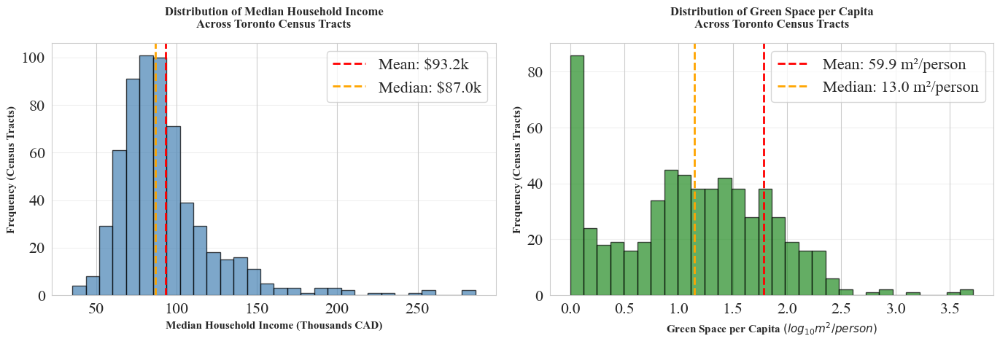

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Income distribution
axes[0].hist(analysis_data['MEDIAN_INCOME']/1000, bins=30, color='steelblue', edgecolor='black', alpha=0.7)
axes[0].axvline(analysis_data['MEDIAN_INCOME'].mean()/1000, color='red', linestyle='--', 
                linewidth=2, label=f'Mean: ${analysis_data["MEDIAN_INCOME"].mean()/1000:.1f}k')
axes[0].axvline(analysis_data['MEDIAN_INCOME'].median()/1000, color='orange', linestyle='--', 
                linewidth=2, label=f'Median: ${analysis_data["MEDIAN_INCOME"].median()/1000:.1f}k')
axes[0].set_xlabel('Median Household Income (Thousands CAD)', fontsize=11, fontweight='bold')
axes[0].set_ylabel('Frequency (Census Tracts)', fontsize=11, fontweight='bold')
axes[0].set_title('Distribution of Median Household Income\nAcross Toronto Census Tracts', 
                  fontsize=12, fontweight='bold', pad=15)
axes[0].legend()
axes[0].grid(axis='y', alpha=0.3)

# Green space distribution (log scale for better visualization)
axes[1].hist(np.log10(analysis_data['GREEN_SPACE_PER_CAPITA'] + 1), bins=30, 
             color='forestgreen', edgecolor='black', alpha=0.7)
axes[1].axvline(np.log10(analysis_data['GREEN_SPACE_PER_CAPITA'].mean() + 1), color='red', 
                linestyle='--', linewidth=2, 
                label=f'Mean: {analysis_data["GREEN_SPACE_PER_CAPITA"].mean():.1f} m²/person')
axes[1].axvline(np.log10(analysis_data['GREEN_SPACE_PER_CAPITA'].median() + 1), color='orange', 
                linestyle='--', linewidth=2, 
                label=f'Median: {analysis_data["GREEN_SPACE_PER_CAPITA"].median():.1f} m²/person')
axes[1].set_xlabel('Green Space per Capita $(log_{10} m^2/{person})$', fontsize=11, fontweight='bold')
axes[1].set_ylabel('Frequency (Census Tracts)', fontsize=11, fontweight='bold')
axes[1].set_title('Distribution of Green Space per Capita\nAcross Toronto Census Tracts', 
                  fontsize=12, fontweight='bold', pad=15)
axes[1].legend()
axes[1].grid(axis='y', alpha=0.3)

plt.rcParams['font.family'] = 'serif'  # or 'sans-serif', 'monospace', 'cursive', 'fantasy'
plt.rcParams['font.serif'] = ['Times New Roman']  # Specific fonts
plt.rcParams['font.size'] = 16

plt.tight_layout()
plt.show()

### 2.3 Correlation Analysis

The relationship between median household income and green space per capita is examined through Pearson's correlation coefficient and bivariate visualization.

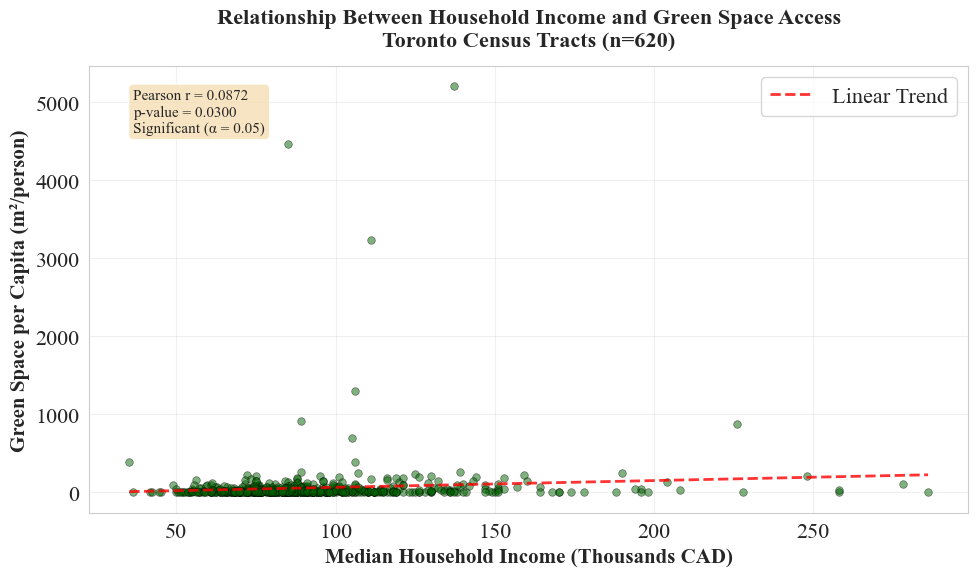

In [32]:
correlation, p_value = stats.pearsonr(analysis_data['MEDIAN_INCOME'], 
                                       analysis_data['GREEN_SPACE_PER_CAPITA'])

fig, ax = plt.subplots(figsize=(10, 6))

# Scatter plot with trend line
ax.scatter(analysis_data['MEDIAN_INCOME']/1000, analysis_data['GREEN_SPACE_PER_CAPITA'], 
           alpha=0.5, s=30, color='darkgreen', edgecolors='black', linewidth=0.5)

# Add trend line
z = np.polyfit(analysis_data['MEDIAN_INCOME'], analysis_data['GREEN_SPACE_PER_CAPITA'], 1)
p = np.poly1d(z)
x_line = np.linspace(analysis_data['MEDIAN_INCOME'].min(), analysis_data['MEDIAN_INCOME'].max(), 100)
ax.plot(x_line/1000, p(x_line), "r--", linewidth=2, alpha=0.8, label='Linear Trend')

# Add statistical annotation
textstr = f'Pearson r = {correlation:.4f}\np-value = {p_value:.4f}\n{"Significant" if p_value < 0.05 else "Not Significant"} (α = 0.05)'
props = dict(boxstyle='round', facecolor='wheat', alpha=0.8)
ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=11,
        verticalalignment='top', bbox=props)

ax.set_xlabel('Median Household Income (Thousands CAD)', fontsize=15, fontweight='bold')
ax.set_ylabel('Green Space per Capita (m²/person)', fontsize=15, fontweight='bold')
ax.set_title('Relationship Between Household Income and Green Space Access\nToronto Census Tracts (n=620)', 
             fontsize=16, fontweight='bold', pad=15)
ax.legend()
ax.grid(True, alpha=0.3)

plt.rcParams['font.family'] = 'serif'  # or 'sans-serif', 'monospace', 'cursive', 'fantasy'
plt.rcParams['font.serif'] = ['Times New Roman']  # Specific fonts
plt.rcParams['font.size'] = 14

plt.tight_layout()
plt.show()

### 2.4 Comparative Analysis by Income Quartile

Census tracts are stratified into income quartiles to examine differences in green space access across economic groups.

In [13]:
quartile_summary = analysis_data.groupby('INCOME_QUARTILE', observed=True).agg({
    'MEDIAN_INCOME': ['mean', 'median'],
    'GREEN_SPACE_PER_CAPITA': ['mean', 'median'],
    'POPULATION': 'sum',
    'DGUID': 'count'
}).round(2)

quartile_summary.columns = ['Mean Income', 'Median Income', 'Mean Green Space (m²/person)', 
                            'Median Green Space (m²/person)', 'Total Population', 'Census Tracts']
quartile_summary

,Mean Income,Median Income,Mean Green Space (m²/person),Median Green Space (m²/person),Total Population,Census Tracts
INCOME_QUARTILE,,,,,,
Q1 (Lowest),64376.10,66500.0,25.94,8.98,790636.0,159
Q2,81003.21,81000.0,54.81,11.21,805369.0,156
Q3,94006.67,93000.0,38.40,16.02,748360.0,150
Q4 (Highest),134296.77,121000.0,120.54,22.50,637933.0,155


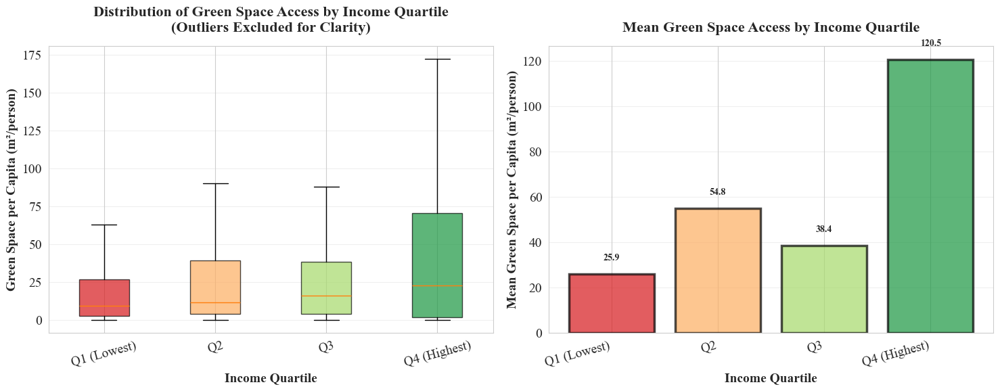

In [35]:
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Box plot showing distribution
quartile_order = ['Q1 (Lowest)', 'Q2', 'Q3', 'Q4 (Highest)']
bp = axes[0].boxplot([analysis_data[analysis_data['INCOME_QUARTILE'] == q]['GREEN_SPACE_PER_CAPITA'] 
                       for q in quartile_order],
                      tick_labels=quartile_order,
                      patch_artist=True,
                      showfliers=False)

for patch, color in zip(bp['boxes'], ['#d7191c', '#fdae61', '#a6d96a', '#1a9641']):
    patch.set_facecolor(color)
    patch.set_alpha(0.7)

axes[0].set_ylabel('Green Space per Capita (m²/person)', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Income Quartile', fontsize=14, fontweight='bold')
axes[0].set_title('Distribution of Green Space Access by Income Quartile\n(Outliers Excluded for Clarity)', 
                  fontsize=16, fontweight='bold', pad=15)
axes[0].grid(axis='y', alpha=0.3)
axes[0].tick_params(axis='x', rotation=15)

# Bar plot showing mean values
quartile_means = analysis_data.groupby('INCOME_QUARTILE', observed=True)['GREEN_SPACE_PER_CAPITA'].mean()
quartile_means = quartile_means.reindex(quartile_order)
colors = ['#d7191c', '#fdae61', '#a6d96a', '#1a9641']
bars = axes[1].bar(range(len(quartile_order)), quartile_means, color=colors, alpha=0.7, 
                   edgecolor='black', linewidth=1.5)

# Add value labels on bars
for i, (bar, value) in enumerate(zip(bars, quartile_means)):
    axes[1].text(bar.get_x() + bar.get_width()/2, bar.get_height() + 5, 
                f'{value:.1f}', ha='center', va='bottom', fontweight='bold', fontsize=10)

axes[1].set_ylabel('Mean Green Space per Capita (m²/person)', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Income Quartile', fontsize=14, fontweight='bold')
axes[1].set_title('Mean Green Space Access by Income Quartile', 
                  fontsize=16, fontweight='bold', pad=15)
axes[1].set_xticks(range(len(quartile_order)))
axes[1].set_xticklabels(quartile_order, rotation=15, ha='right')
axes[1].grid(axis='y', alpha=0.3)

plt.rcParams['font.family'] = 'serif'  # or 'sans-serif', 'monospace', 'cursive', 'fantasy'
plt.rcParams['font.serif'] = ['Times New Roman']  # Specific fonts
plt.rcParams['font.size'] = 14

plt.tight_layout()
plt.show()

The analysis reveals substantial disparities in green space access across income quartiles. Census tracts in the highest income quartile (Q4) possess mean green space per capita approximately 4.65 times greater than those in the lowest quartile (Q1), representing a difference of 94.6 m²/person.

### 2.5 Spatial Visualization

An interactive choropleth map displays the spatial distribution of green space per capita across Toronto census tracts. Due to the high variance in the data (ranging from 0 to over 5,000 m²/person), a logarithmic transformation (log₁₀) is applied to improve visual interpretability of the spatial patterns.

In [36]:
analysis_data['GREEN_SPACE_PER_CAPITA_LOG'] = np.log10(analysis_data['GREEN_SPACE_PER_CAPITA'] + 1)

center_lat = analysis_data.to_crs(epsg=26917).geometry.centroid.to_crs(epsg=4326).y.mean()
center_lon = analysis_data.to_crs(epsg=26917).geometry.centroid.to_crs(epsg=4326).x.mean()

toronto_map = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=11,
    tiles='OpenStreetMap'
)

folium.Choropleth(
    geo_data=analysis_data,
    name='Green Space per Capita (Log Scale)',
    data=analysis_data,
    columns=['DGUID', 'GREEN_SPACE_PER_CAPITA_LOG'],
    key_on='feature.properties.DGUID',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.3,
    legend_name='Green Space per Capita (log₁₀ m²/person)'
).add_to(toronto_map)

folium.GeoJson(
    analysis_data,
    name='Census Tract Details',
    tooltip=folium.GeoJsonTooltip(
        fields=['CTUID', 'POPULATION', 'MEDIAN_INCOME', 'GREEN_SPACE_PER_CAPITA', 'INCOME_QUARTILE'],
        aliases=['Census Tract:', 'Population:', 'Median Income ($):', 
                 'Green Space/Person (m²):', 'Income Quartile:'],
        localize=True,
        sticky=False,
        labels=True
    ),
    style_function=lambda x: {
        'fillColor': 'transparent',
        'color': 'transparent',
        'weight': 0
    }
).add_to(toronto_map)

folium.GeoJson(
    green_spaces,
    name='Green Spaces',
    style_function=lambda x: {
        'fillColor': 'darkgreen',
        'color': 'darkgreen',
        'weight': 1,
        'fillOpacity': 0.6
    },
    tooltip=folium.Tooltip('Green Space')
).add_to(toronto_map)

folium.LayerControl().add_to(toronto_map)

toronto_map

The interactive map is exported as an HTML file for viewing in web browsers. Users may toggle between the choropleth layer showing green space distribution and the overlay of actual green space polygons to examine the relationship between census tract boundaries and municipal parkland.

In [16]:
output_file = 'greenspace_per_capita_log_map.html'
toronto_map.save(output_file)

## 3. Discussion

### 3.1 Key Findings

This analysis of 620 census tracts across Toronto reveals a statistically significant positive correlation (r = 0.087, p = 0.030) between median household income and green space per capita, indicating that higher-income areas have greater access to green space. While the correlation coefficient is modest, the quartile-based analysis demonstrates substantial practical differences: census tracts in the highest income quartile (Q4) have mean green space access of 120.5 m²/person compared to 25.9 m²/person in the lowest quartile (Q1), representing a 4.65-fold disparity.

The spatial visualization confirms that green space distribution is not uniform across the city, with notable clustering of high green space access in peripheral, higher-income neighborhoods. Conversely, lower-income census tracts, often located in the city's core and inner suburbs, demonstrate markedly reduced access to proximate green space.

### 3.2 Implications

These findings align with research from other Canadian cities documenting environmental inequities in urban green space distribution. The disparity in access has implications for public health, as access to green space has been associated with improved mental health outcomes, increased physical activity, and enhanced overall well-being. Lower-income populations, who may face multiple health stressors, experience compounded disadvantage through reduced access to these environmental amenities.

### 3.3 Limitations

This analysis has several limitations. First, green space per capita does not account for quality, accessibility, or usability of green spaces—a large ravine may contribute to the per capita calculation but may not provide the same recreational value as a well-maintained park. Second, the analysis uses census tract boundaries, which may not reflect actual activity spaces or perceived neighborhoods. Third, the study examines correlation but cannot establish causality in the relationship between income and green space access.

Future research could incorporate measures of green space quality, walkability analysis to assess practical access, and temporal analysis to examine changes in green space distribution over multiple census periods.

## 4. Conclusion

This study provides empirical evidence of income-based disparities in green space access across Toronto's census tracts. The analysis demonstrates that while a positive correlation exists between household income and green space per capita, the relationship exhibits considerable heterogeneity across the urban landscape. The 4.65-fold difference in mean green space access between the highest and lowest income quartiles suggests that green space distribution in Toronto reflects broader patterns of socioeconomic inequality.

These findings underscore the importance of equitable urban planning policies that prioritize green space development in underserved, lower-income neighborhoods. Ensuring equitable access to environmental amenities is fundamental to environmental justice and public health equity in urban contexts.

---

**Data Sources:**
- [Statistics Canada. (2021). Census Profile, 2021 Census of Population.](https://www12.statcan.gc.ca/census-recensement/2021/dp-pd/prof/details/download-telecharger.cfm?Lang=E)
- [Statistics Canada. (2021). Census Tract Boundary Files.](https://www12.statcan.gc.ca/census-recensement/2021/geo/sip-pis/boundary-limites/index2021-eng.cfm?Year=21)
- [City of Toronto. (2022). Green Spaces Shapefile.](https://open.toronto.ca/dataset/green-spaces/)